In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [2]:
df0=pd.read_csv('Data1/gases.csv')
df0.head()

df1=pd.read_csv('Data1/gases_mompean_1.csv', )
print(df1.head())
df2=pd.read_csv('Data1/gases_mompean_2.csv', )
print(df2.head())
df3=pd.read_csv('Data1/gases_mompean_3.csv', )
print(df3.head())
df4 = pd.read_csv('Data1/test.csv', )

df = pd.concat([df0,df1, df2,df3,df4], axis=0)

df.head(10)

   SO2_ae  SO2_we  NO2_ae  NO2_we  CO_ae  CO_we  O3_we  O3_ae  SO2_Mompean  \
0     347     351     223     213    372    444    233    219            7   
1     348     354     225     209    384    442    226    222            8   
2     349     356     222     207    375    435    225    219            8   
3     349     355     222     211    369    444    228    218            9   
4     349     353     222     217    368    462    233    218            7   

   NO2_Mompean  CO_Mompean  O3_Mompean  Temperatura  Humedad  
0            2         0.3          74         33.8     47.0  
1            2         0.3          75         37.5     39.3  
2            2         0.3          72         38.9     37.0  
3            2         0.3          70         38.4     37.7  
4            2         0.3          66         36.7     42.5  
   SO2_ae  SO2_we  NO2_ae  NO2_we  CO_ae  CO_we  O3_we  O3_ae  SO2_Mompean  \
0     358     389     229     242    331    484    225    224            3 

,Day,Time,NO2_we,NO2_ae,Sensibilidad_NO2,ppb_NO2,O3_we,O3_ae,Sensibilidad_O3,ppb_03,...,Temperatura,Humedad,ug/m3_NO2_Sensor,ug/m3_O3_Sensor,ug/m3_SO2_Sensor,ug/m3_CO_Sensor,NO2_Mompean,CO_Mompean,O3_Mompean,SO2_Mompean
0,'5/5/21','10:00',231.897985,227.435182,0.261,17.098862,234.081870,227.570459,0.35,18.604034,...,26.1,50.8,32.036099,36.367296,228.034624,95.964213,16,0.3,53,9
1,'5/5/21','11:00',231.119590,228.038433,0.261,11.805201,237.919148,228.696986,0.35,26.349033,...,26.9,49.5,22.059026,51.369944,227.053463,121.318015,12,0.2,64,8
2,'5/5/21','12:00',229.071089,229.268249,0.261,-0.755400,233.436220,227.519084,0.35,16.906103,...,30.3,42.3,-1.395713,32.590754,231.330373,64.333234,13,0.2,61,7
3,'5/5/21','13:00',227.583855,227.728481,0.261,-0.554122,234.630719,225.650348,0.35,25.658205,...,30.6,41.4,-1.022811,49.413776,247.802624,73.346056,12,0.2,63,5
4,'5/5/21','14:00',227.624575,227.931468,0.261,-1.175838,234.066116,225.371827,0.35,24.840824,...,32.4,38.6,-2.157604,47.557800,265.794803,65.830052,18,0.2,53,6
5,'5/5/21','15:00',227.291782,226.489937,0.261,3.072201,235.852504,224.863073,0.35,31.398374,...,31.8,39.0,5.648427,60.230514,288.119904,123.737886,15,0.2,60,6
6,'5/5/21','16:00',228.399202,225.874952,0.261,9.671459,238.484111,224.930848,0.35,38.723607,...,30.7,41.3,17.845935,74.551196,297.104749,150.538236,13,0.2,67,6
7,'5/5/21','17:00',230.491785,225.486709,0.261,19.176538,240.992237,225.651070,0.35,43.831907,...,28.9,44.9,35.595732,84.888639,286.584407,175.339188,12,0.2,68,6
8,'5/5/21','18:00',231.775710,224.165945,0.261,29.156186,244.100372,226.366972,0.35,50.666858,...,26.1,51.4,54.626467,99.043930,263.390381,190.264520,12,0.2,69,6
9,'5/5/21','19:00',235.820826,224.190143,0.261,44.562005,247.830627,228.368969,0.35,55.604739,...,21.6,62.9,84.765177,110.356022,228.852071,210.557072,11,0.2,70,6


In [3]:
df.tail()

,Day,Time,NO2_we,NO2_ae,Sensibilidad_NO2,ppb_NO2,O3_we,O3_ae,Sensibilidad_O3,ppb_03,...,Temperatura,Humedad,ug/m3_NO2_Sensor,ug/m3_O3_Sensor,ug/m3_SO2_Sensor,ug/m3_CO_Sensor,NO2_Mompean,CO_Mompean,O3_Mompean,SO2_Mompean
14,NaN,NaN,247.0,254.0,NaN,NaN,247.0,235.0,NaN,NaN,...,11.6,85.3,NaN,NaN,NaN,NaN,10,0.2,39,1
15,NaN,NaN,246.0,254.0,NaN,NaN,247.0,235.0,NaN,NaN,...,11.7,83.7,NaN,NaN,NaN,NaN,8,0.2,43,1
16,NaN,NaN,246.0,254.0,NaN,NaN,249.0,235.0,NaN,NaN,...,11.9,83.2,NaN,NaN,NaN,NaN,9,0.2,55,1
17,NaN,NaN,245.0,254.0,NaN,NaN,247.0,235.0,NaN,NaN,...,12.3,80.1,NaN,NaN,NaN,NaN,10,0.2,49,2
18,NaN,NaN,248.0,254.0,NaN,NaN,248.0,235.0,NaN,NaN,...,12.2,81.7,NaN,NaN,NaN,NaN,23,0.2,25,1


In [4]:
training_data, testing_data = train_test_split(df, test_size=0.1, random_state=25)
len(training_data)
len(testing_data)

56

# N02

In [20]:
NO2 = training_data[['NO2_we','NO2_ae']].values
NO2T = training_data[['NO2_we','NO2_ae','Temperatura']].values
NO2TH  = training_data[['NO2_we','NO2_ae','Temperatura','Humedad']].values
NO2_we = training_data[['NO2_we']].values
NO2_mo = training_data[['NO2_Mompean']].values

In [21]:
# NO2T.head()
len(NO2TH)

498

In [22]:
type(training_data)

pandas.core.frame.DataFrame

In [23]:
NO2t = testing_data[['NO2_we','NO2_ae']].values
NO2Tt = testing_data[['NO2_we','NO2_ae','Temperatura']].values
NO2THt  = testing_data[['NO2_we','NO2_ae','Temperatura','Humedad']].values
NO2_wet = testing_data[['NO2_we']].values
NO2_mot = testing_data[['NO2_Mompean']].values

In [24]:
print(len(NO2_wet))
print(len(NO2_mo))
print(len(NO2_we))
# reg.predict(NO2t)

56
498
498


In [25]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression

# Linear

In [26]:
reg = LinearRegression().fit(NO2, NO2_mo)

In [27]:
print(reg.score(NO2t, NO2_mot))
print(reg.coef_)

0.1975687520385241
[[0.45935622 0.05151631]]


In [28]:
reg.predict([[231.8979854, 227.4351823]])

array([[14.33045016]])

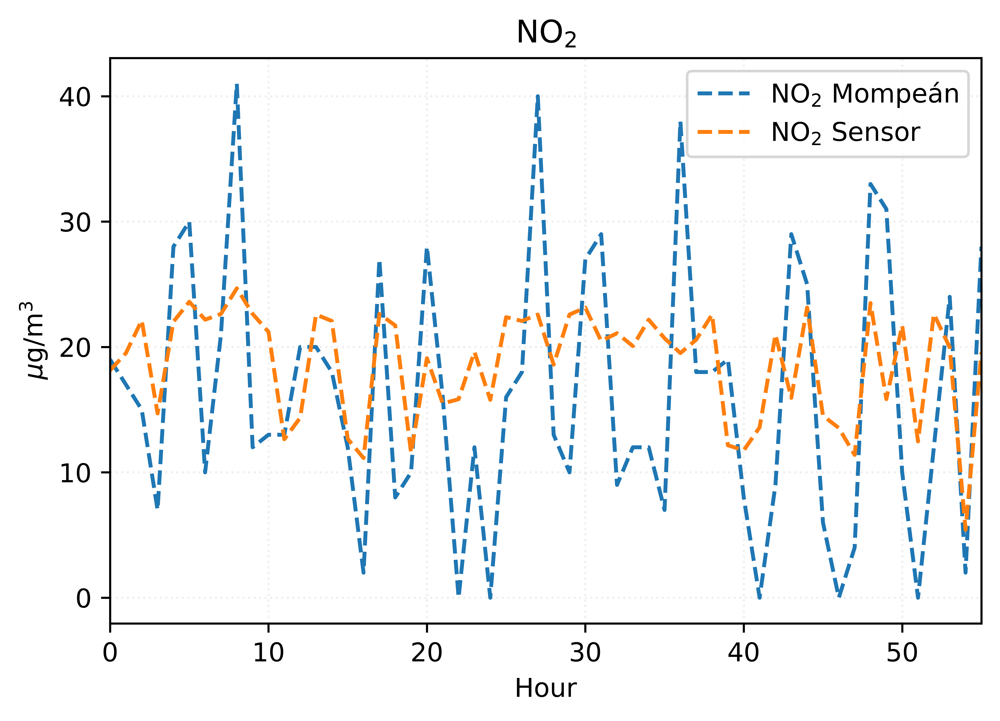

In [29]:
def plotting(X,Y,model):    
    fig = plt.figure(figsize=(6, 4), dpi = 1200)

    ax = fig.gca()
    ax.plot(range(0, len(Y)), Y, label=r'NO$_{2}$ Mompeán', ls='--')
    ax.plot(range(0, len(X)), model.predict(X), label=r'NO$_{2}$ Sensor', ls='--')

    ax.set_xlim(0, len(Y)-1)

    ax.set_xlabel(r'Hour')
    ax.set_ylabel(r'$\mu$g/m$^3$')
    ax.set_title(r'NO$_2$')

    ax.grid(ls='dotted', alpha=0.2)
    ax.legend()

    plt.show()
    
plotting(NO2t,NO2_mot,reg)
# fig = plt.figure(figsize=(6, 4), dpi = 1200)

# ax = fig.gca()
# ax.plot(range(0, len(NO2_mot)), NO2_mot, label=r'NO$_{2}$ Mompeán', ls='--')
# ax.plot(range(0, len(NO2_wet)), reg.predict(NO2t), label=r'NO$_{2}$ Sensor', ls='--')

# ax.set_xlim(0, len(NO2_mot)-1)

# ax.set_xlabel(r'Hour')
# ax.set_ylabel(r'$\mu$g/m$^3$')
# ax.set_title(r'NO$_2$')

# ax.grid(ls='dotted', alpha=0.2)
# ax.legend()

# plt.show()

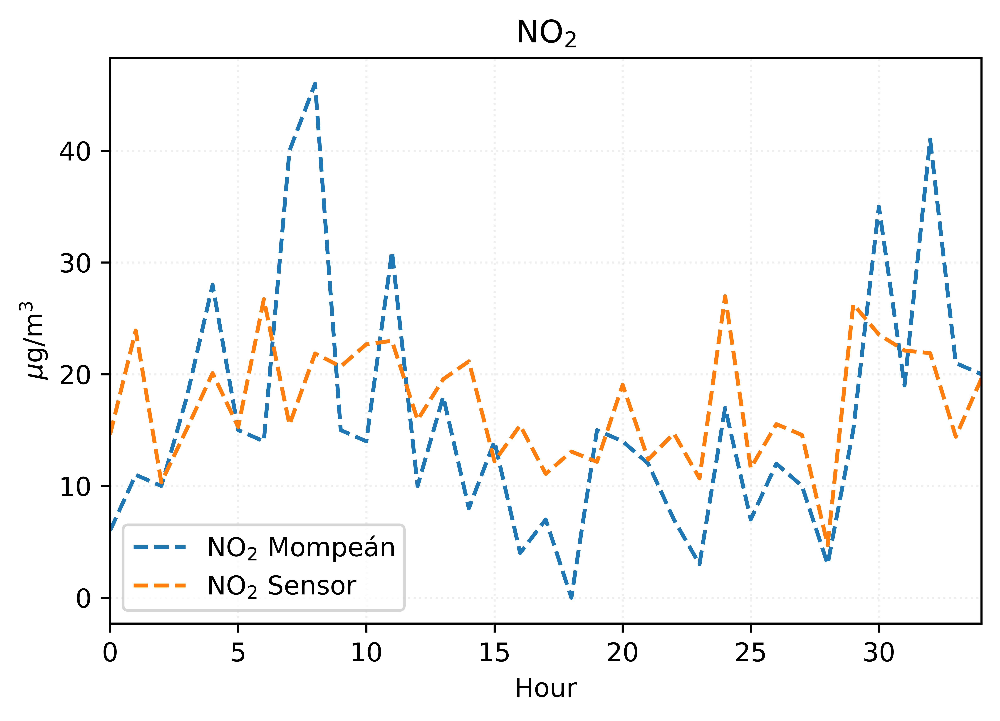

In [30]:
plot = training_data.sample(n=35)
plotting(plot[['NO2_we','NO2_ae']].values, plot[['NO2_Mompean']].values, reg)

In [31]:
reg = LinearRegression().fit(NO2T, NO2_mo)
print(reg.score(NO2T, NO2_mo))
print(reg.coef_)

0.2016555478601948
[[ 0.40038025  0.05038308 -0.13950014]]


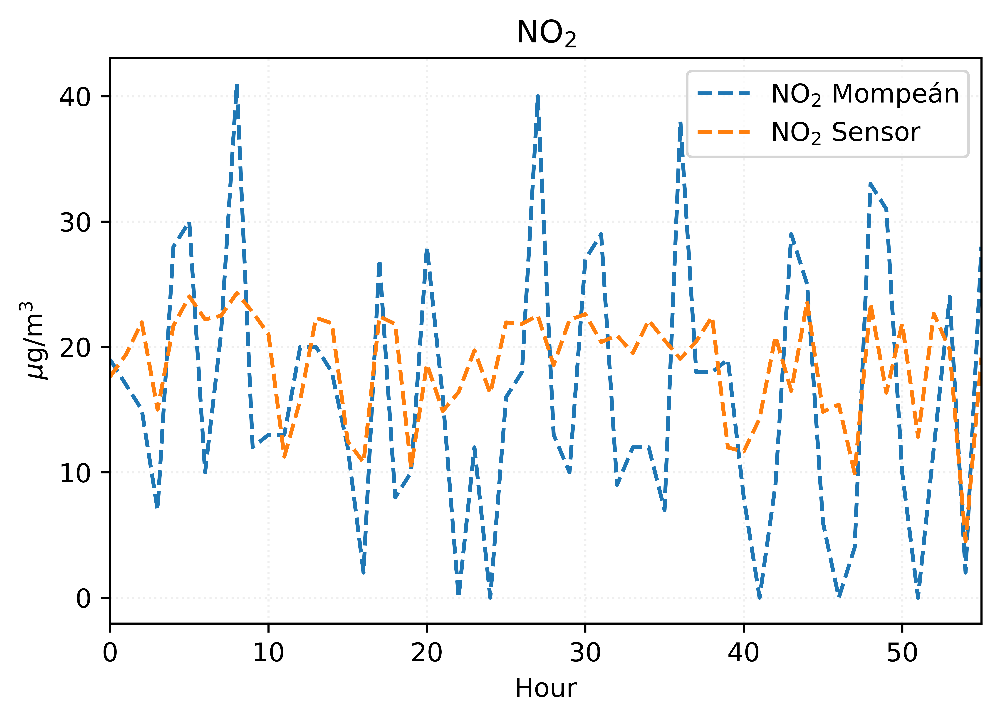

In [32]:
plotting(NO2Tt,NO2_mot,reg)

In [33]:
reg = LinearRegression().fit(NO2TH, NO2_mo)
print(reg.score(NO2TH, NO2_mo))
print(reg.coef_)

0.20283490664425463
[[ 0.39408059  0.04742784 -0.21393314 -0.03488438]]


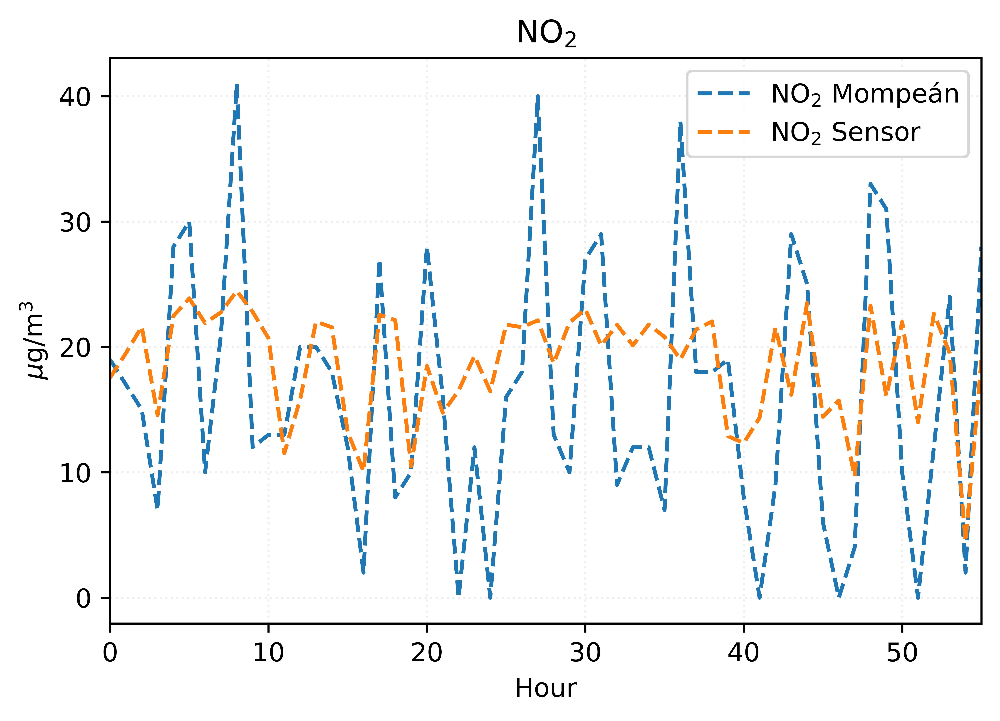

In [34]:
plotting(NO2THt,NO2_mot,reg)

# POLYNOMIAL REGRESSION NO2

In [35]:
# NO2.reshape(47,2)
len(X_multi_trans)

56

In [36]:
# With temperature
poly = PolynomialFeatures(degree=2)
X_multi_trans = poly.fit_transform(NO2T)
print("Input",poly.n_input_features_)
print("Ouput",poly.n_output_features_)
print("Powersn",poly.powers_)
X_multi_trans

Input 3
Ouput 10
Powersn [[0 0 0]
 [1 0 0]
 [0 1 0]
 [0 0 1]
 [2 0 0]
 [1 1 0]
 [1 0 1]
 [0 2 0]
 [0 1 1]
 [0 0 2]]


C:\Users\Acer\.conda\envs\senv\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The attribute `n_input_features_` was deprecated in version 1.0 and will be removed in 1.2.
  warnings.warn(msg, category=FutureWarning)


array([[1.00000e+00, 2.42000e+02, 2.31000e+02, ..., 5.33610e+04,
        4.11180e+03, 3.16840e+02],
       [1.00000e+00, 2.37000e+02, 2.90000e+02, ..., 8.41000e+04,
        3.39300e+03, 1.36890e+02],
       [1.00000e+00, 2.50000e+02, 2.52000e+02, ..., 6.35040e+04,
        2.45952e+03, 9.52576e+01],
       ...,
       [1.00000e+00, 2.45000e+02, 2.53000e+02, ..., 6.40090e+04,
        3.28900e+03, 1.69000e+02],
       [1.00000e+00, 2.49000e+02, 2.51000e+02, ..., 6.30010e+04,
        3.08730e+03, 1.51290e+02],
       [1.00000e+00, 2.29000e+02, 2.30000e+02, ..., 5.29000e+04,
        5.19800e+03, 5.10760e+02]])

In [37]:
reg = LinearRegression()
reg.fit(X_multi_trans, NO2_mo)

LinearRegression()

In [38]:
print(reg.score(X_multi_trans,NO2_mo))
print(reg.coef_)
print(reg.intercept_)

0.2855017537989887
[[ 0.00000000e+00 -8.24895922e+00  8.32463313e+00  6.04351718e+00
   3.52809429e-02 -3.42713745e-02  3.97980341e-03  7.05747492e-04
  -2.38332622e-02 -4.03521621e-02]]
[-108.53900196]


In [39]:
# reg.predict([[1,2,3,4,5,6,7,8,6,4]])
X_multi_trans = poly.fit_transform(NO2Tt)

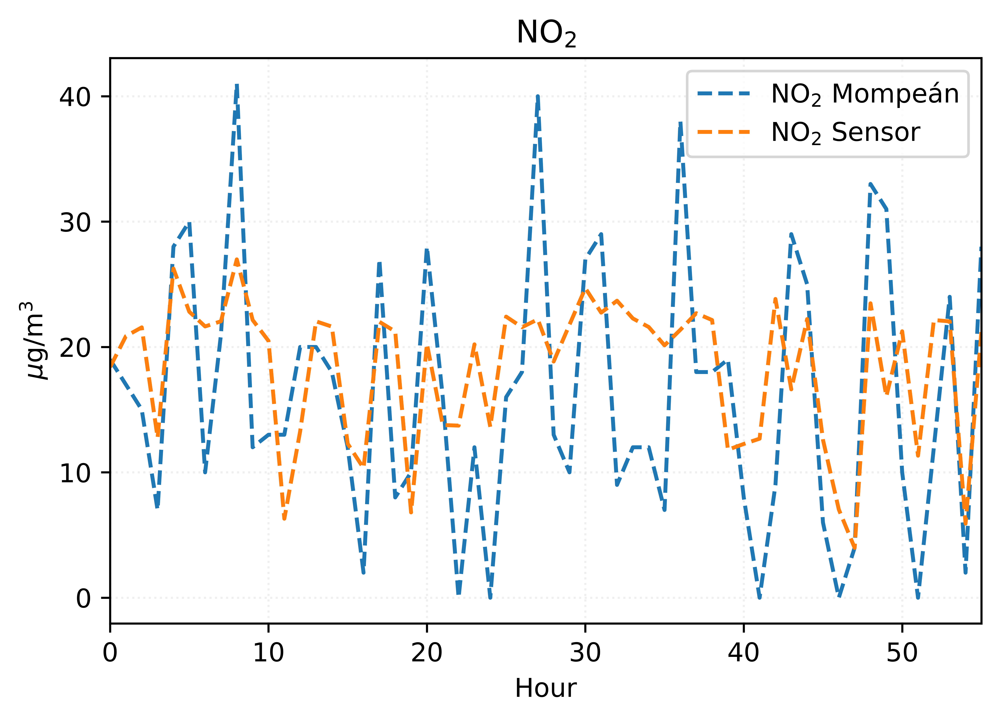

In [69]:
plotting(X_multi_trans, NO2_mot, reg)


# fig = plt.figure(figsize=(6, 4), dpi = 1200)

# ax = fig.gca()
# ax.plot(range(0, len(NO2_mo)), NO2_mo, label=r'NO$_{2}$ Mompeán', ls='--')
# ax.plot(range(0, len(NO2T)), reg.predict(X_multi_trans), label=r'NO$_{2}$ Sensor', ls='--')

# ax.set_xlim(0, len(NO2_mo)-1)

# ax.set_xlabel(r'Hour')
# ax.set_ylabel(r'$\mu$g/m$^3$')
# ax.set_title(r'NO$_2$')

# ax.grid(ls='dotted', alpha=0.2)
# ax.legend()

# plt.show()

In [70]:
# with temperature and humidity

poly = PolynomialFeatures(degree=4)
X_multi_trans = poly.fit_transform(NO2TH)
print("Input",poly.n_input_features_)
print("Ouput",poly.n_output_features_)
print("Powersn",poly.powers_)
reg = LinearRegression()
reg.fit(X_multi_trans, NO2_mo)
print(reg.score(X_multi_trans,NO2_mo))
print(reg.coef_)
print(reg.intercept_)

Input 4
Ouput 70
Powersn [[0 0 0 0]
 [1 0 0 0]
 [0 1 0 0]
 [0 0 1 0]
 [0 0 0 1]
 [2 0 0 0]
 [1 1 0 0]
 [1 0 1 0]
 [1 0 0 1]
 [0 2 0 0]
 [0 1 1 0]
 [0 1 0 1]
 [0 0 2 0]
 [0 0 1 1]
 [0 0 0 2]
 [3 0 0 0]
 [2 1 0 0]
 [2 0 1 0]
 [2 0 0 1]
 [1 2 0 0]
 [1 1 1 0]
 [1 1 0 1]
 [1 0 2 0]
 [1 0 1 1]
 [1 0 0 2]
 [0 3 0 0]
 [0 2 1 0]
 [0 2 0 1]
 [0 1 2 0]
 [0 1 1 1]
 [0 1 0 2]
 [0 0 3 0]
 [0 0 2 1]
 [0 0 1 2]
 [0 0 0 3]
 [4 0 0 0]
 [3 1 0 0]
 [3 0 1 0]
 [3 0 0 1]
 [2 2 0 0]
 [2 1 1 0]
 [2 1 0 1]
 [2 0 2 0]
 [2 0 1 1]
 [2 0 0 2]
 [1 3 0 0]
 [1 2 1 0]
 [1 2 0 1]
 [1 1 2 0]
 [1 1 1 1]
 [1 1 0 2]
 [1 0 3 0]
 [1 0 2 1]
 [1 0 1 2]
 [1 0 0 3]
 [0 4 0 0]
 [0 3 1 0]
 [0 3 0 1]
 [0 2 2 0]
 [0 2 1 1]
 [0 2 0 2]
 [0 1 3 0]
 [0 1 2 1]
 [0 1 1 2]
 [0 1 0 3]
 [0 0 4 0]
 [0 0 3 1]
 [0 0 2 2]
 [0 0 1 3]
 [0 0 0 4]]
0.6655429726731399
[[ 3.19633616e+01 -9.09689142e+03 -3.53095014e+03 -2.41963671e+04
  -1.03584792e+04  3.70478448e+01  2.48340525e+01  8.51798585e+01
   5.26424091e+01 -9.85433793e-01  1.03116626e+02  4.

C:\Users\Acer\.conda\envs\senv\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The attribute `n_input_features_` was deprecated in version 1.0 and will be removed in 1.2.
  warnings.warn(msg, category=FutureWarning)


In [71]:
X_multi_trans = poly.fit_transform(NO2TH)

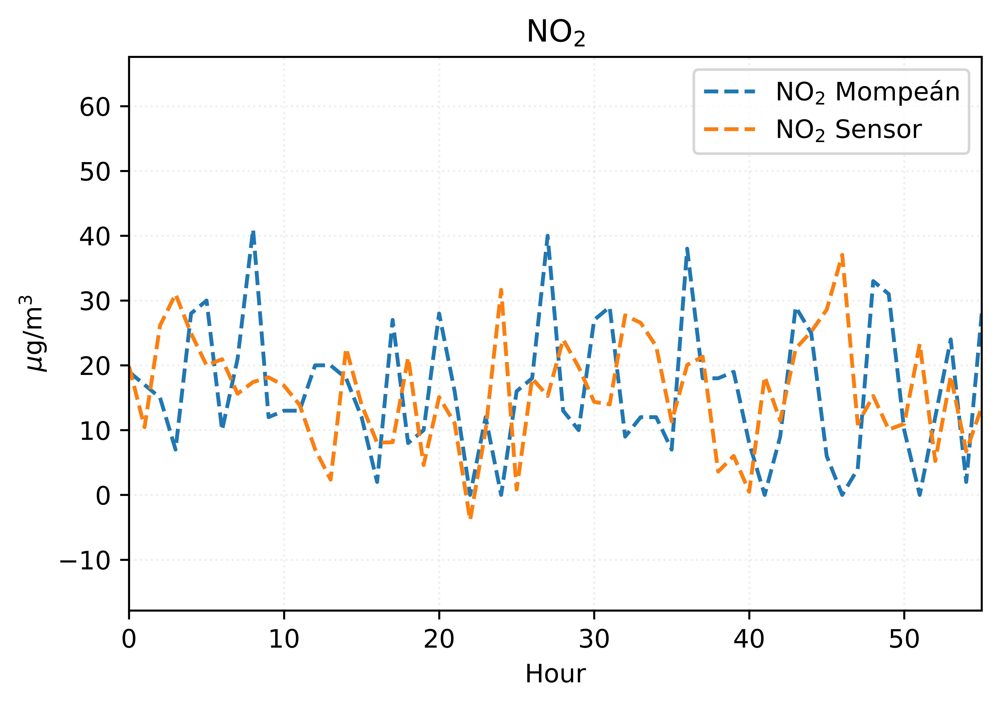

In [72]:
plotting(X_multi_trans, NO2_mot, reg)

# S02

In [75]:
SO2 = training_data[['SO2_we','SO2_ae']].values
SO2T = training_data[['SO2_we','SO2_ae','Temperatura']].values
SO2TH  = training_data[['SO2_we','SO2_ae','Temperatura','Humedad']].values
SO2_we = training_data[['SO2_we']].values
SO2_mo = training_data[['SO2_Mompean']].values

SO2t = testing_data[['SO2_we','SO2_ae']].values
SO2Tt = testing_data[['SO2_we','SO2_ae','Temperatura']].values
SO2THt  = testing_data[['SO2_we','SO2_ae','Temperatura','Humedad']].values
SO2_wet = testing_data[['SO2_we']].values
SO2_mot = testing_data[['SO2_Mompean']].values

# LINEAR SO2

In [95]:
reg = LinearRegression().fit(SO2, SO2_mo)
print(reg.score(SO2, SO2_mo))
print(reg.coef_)

0.171400294243085
[[0.00932068 0.07161715]]


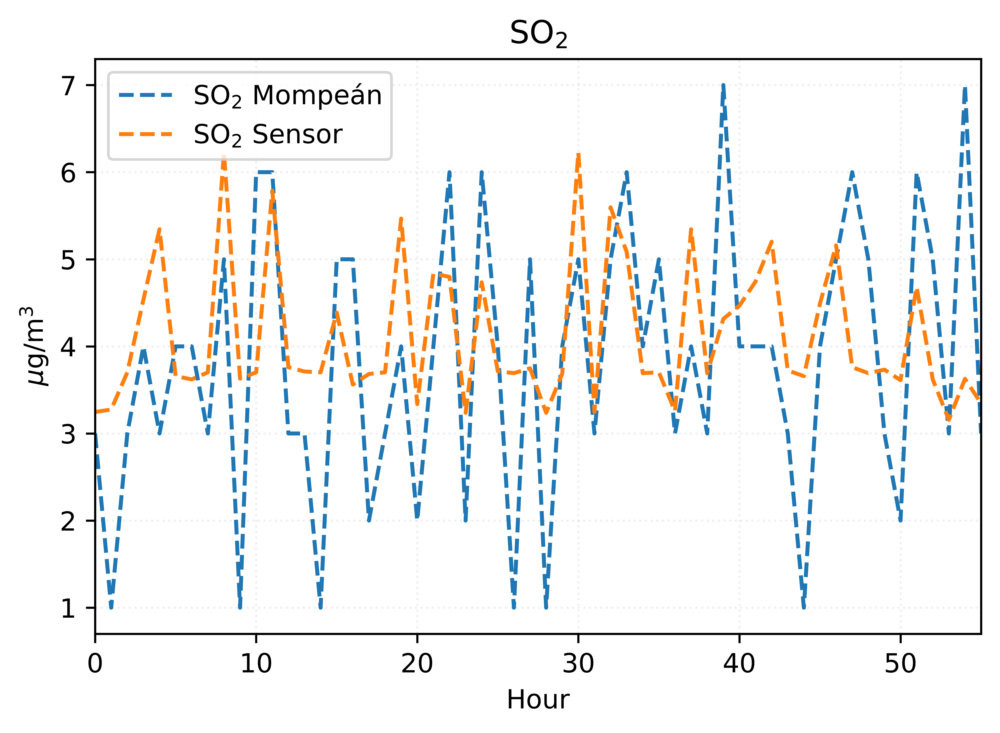

In [96]:

def plotting(X,Y,model):    
    fig = plt.figure(figsize=(6, 4), dpi = 1200)

    ax = fig.gca()
    ax.plot(range(0, len(Y)), Y, label=r'SO$_{2}$ Mompeán', ls='--')
    ax.plot(range(0, len(X)), model.predict(X), label=r'SO$_{2}$ Sensor', ls='--')

    ax.set_xlim(0, len(Y)-1)

    ax.set_xlabel(r'Hour')
    ax.set_ylabel(r'$\mu$g/m$^3$')
    ax.set_title(r'SO$_2$')

    ax.grid(ls='dotted', alpha=0.2)
    ax.legend()

    plt.show()
    
plotting(SO2t,SO2_mot,reg)

0.23663141158584922
[[0.01005963 0.06731165 0.07931159]]


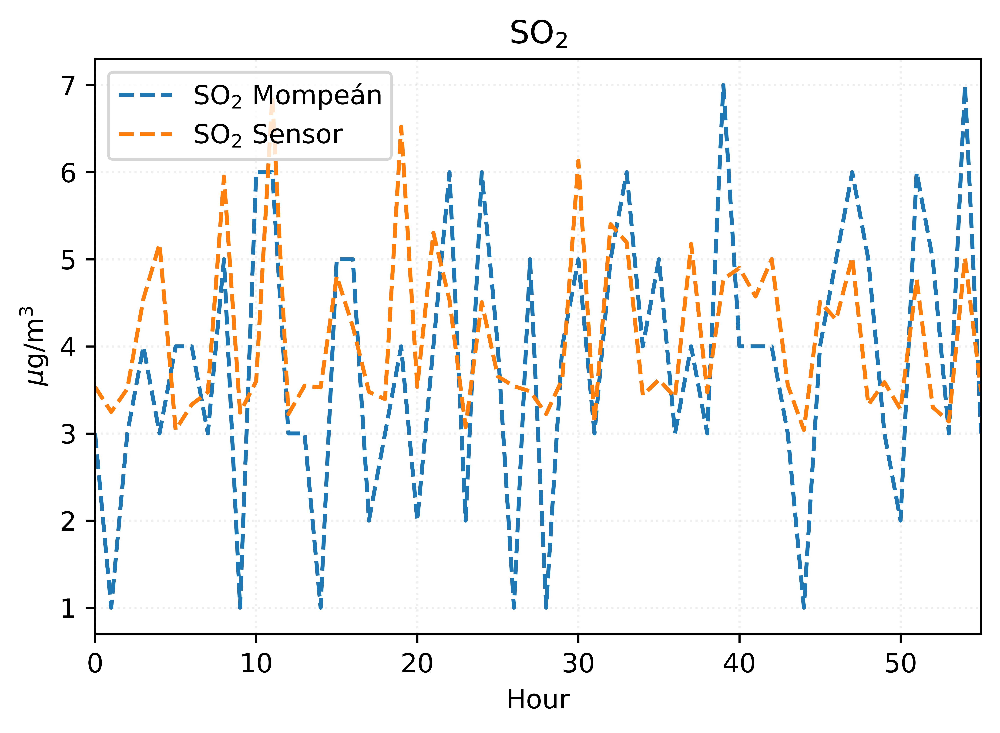

In [97]:
#with temperature
reg = LinearRegression().fit(SO2T, SO2_mo)
print(reg.score(SO2T, SO2_mo))
print(reg.coef_)
plotting(SO2Tt, SO2_mot,reg)

In [98]:
reg = LinearRegression().fit(SO2TH, SO2_mo)
print(reg.score(SO2TH, SO2_mo))
print(reg.coef_)

0.24248196623078055
[[0.0094266  0.07824574 0.10493452 0.01437664]]


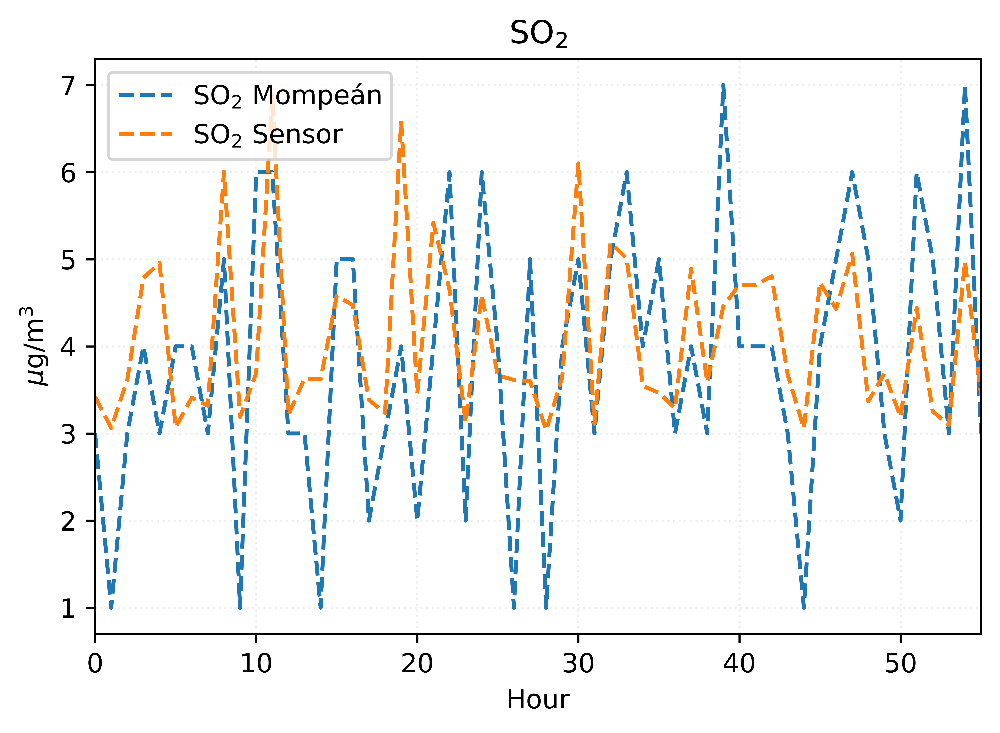

In [99]:
plotting(SO2THt,SO2_mot,reg)

# Polynomial SO2

C:\Users\Acer\.conda\envs\senv\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The attribute `n_input_features_` was deprecated in version 1.0 and will be removed in 1.2.
  warnings.warn(msg, category=FutureWarning)


Input 3
Ouput 10
Powersn [[0 0 0]
 [1 0 0]
 [0 1 0]
 [0 0 1]
 [2 0 0]
 [1 1 0]
 [1 0 1]
 [0 2 0]
 [0 1 1]
 [0 0 2]]
0.3280102254982885
[[ 0.00000000e+00  1.94179061e-01  2.86026209e+00  1.77728496e+00
  -3.36668771e-04  3.43748162e-04 -2.94239623e-03 -4.04686466e-03
  -2.37806107e-03  4.27158455e-03]]
[-570.01114043]


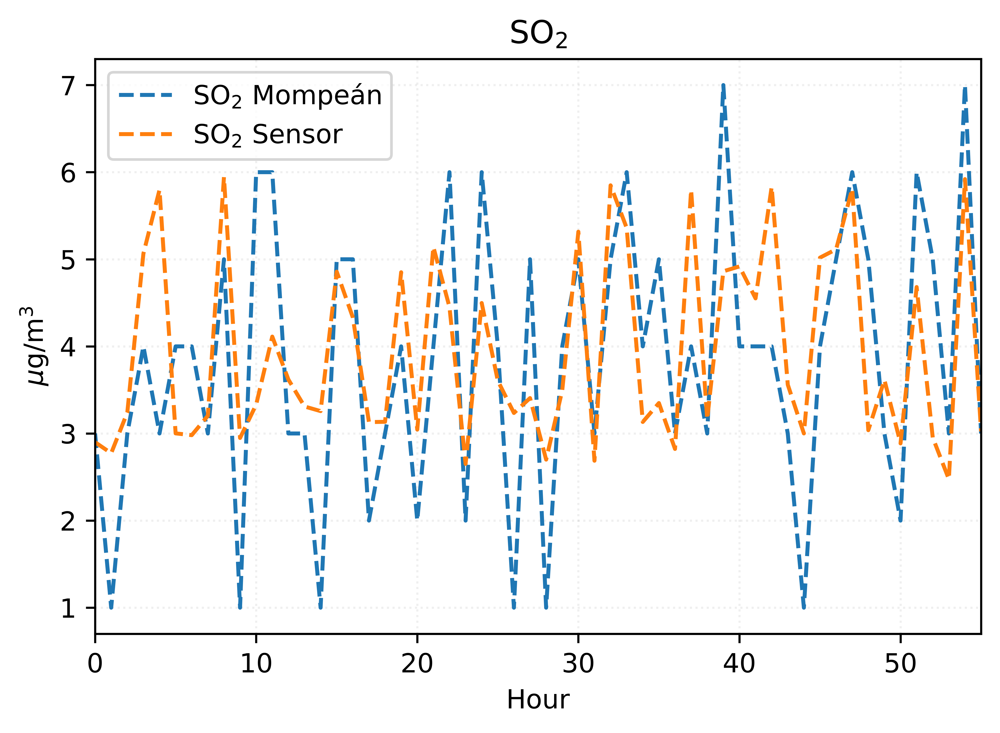

In [79]:
# SO2 with temperature

poly = PolynomialFeatures(degree=2)
X_multi_trans = poly.fit_transform(SO2T)
print("Input",poly.n_input_features_)
print("Ouput",poly.n_output_features_)
print("Powersn",poly.powers_)
reg = LinearRegression()
reg.fit(X_multi_trans, SO2_mo)
print(reg.score(X_multi_trans,SO2_mo))
print(reg.coef_)
print(reg.intercept_)
X_multi_trans = poly.fit_transform(SO2Tt)
plotting(X_multi_trans, SO2_mot, reg)

C:\Users\Acer\.conda\envs\senv\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The attribute `n_input_features_` was deprecated in version 1.0 and will be removed in 1.2.
  warnings.warn(msg, category=FutureWarning)


Input 4
Ouput 70
Powersn [[0 0 0 0]
 [1 0 0 0]
 [0 1 0 0]
 [0 0 1 0]
 [0 0 0 1]
 [2 0 0 0]
 [1 1 0 0]
 [1 0 1 0]
 [1 0 0 1]
 [0 2 0 0]
 [0 1 1 0]
 [0 1 0 1]
 [0 0 2 0]
 [0 0 1 1]
 [0 0 0 2]
 [3 0 0 0]
 [2 1 0 0]
 [2 0 1 0]
 [2 0 0 1]
 [1 2 0 0]
 [1 1 1 0]
 [1 1 0 1]
 [1 0 2 0]
 [1 0 1 1]
 [1 0 0 2]
 [0 3 0 0]
 [0 2 1 0]
 [0 2 0 1]
 [0 1 2 0]
 [0 1 1 1]
 [0 1 0 2]
 [0 0 3 0]
 [0 0 2 1]
 [0 0 1 2]
 [0 0 0 3]
 [4 0 0 0]
 [3 1 0 0]
 [3 0 1 0]
 [3 0 0 1]
 [2 2 0 0]
 [2 1 1 0]
 [2 1 0 1]
 [2 0 2 0]
 [2 0 1 1]
 [2 0 0 2]
 [1 3 0 0]
 [1 2 1 0]
 [1 2 0 1]
 [1 1 2 0]
 [1 1 1 1]
 [1 1 0 2]
 [1 0 3 0]
 [1 0 2 1]
 [1 0 1 2]
 [1 0 0 3]
 [0 4 0 0]
 [0 3 1 0]
 [0 3 0 1]
 [0 2 2 0]
 [0 2 1 1]
 [0 2 0 2]
 [0 1 3 0]
 [0 1 2 1]
 [0 1 1 2]
 [0 1 0 3]
 [0 0 4 0]
 [0 0 3 1]
 [0 0 2 2]
 [0 0 1 3]
 [0 0 0 4]]
0.5775973910308067
[[ 4.37389567e+03 -8.93875123e+02 -1.23434471e+04 -1.33782493e+04
  -6.07397497e+03  6.75278581e-01  6.96423109e+00 -9.77528462e+00
  -2.43112682e+00  4.11548979e+01  1.11978674e+02  4.

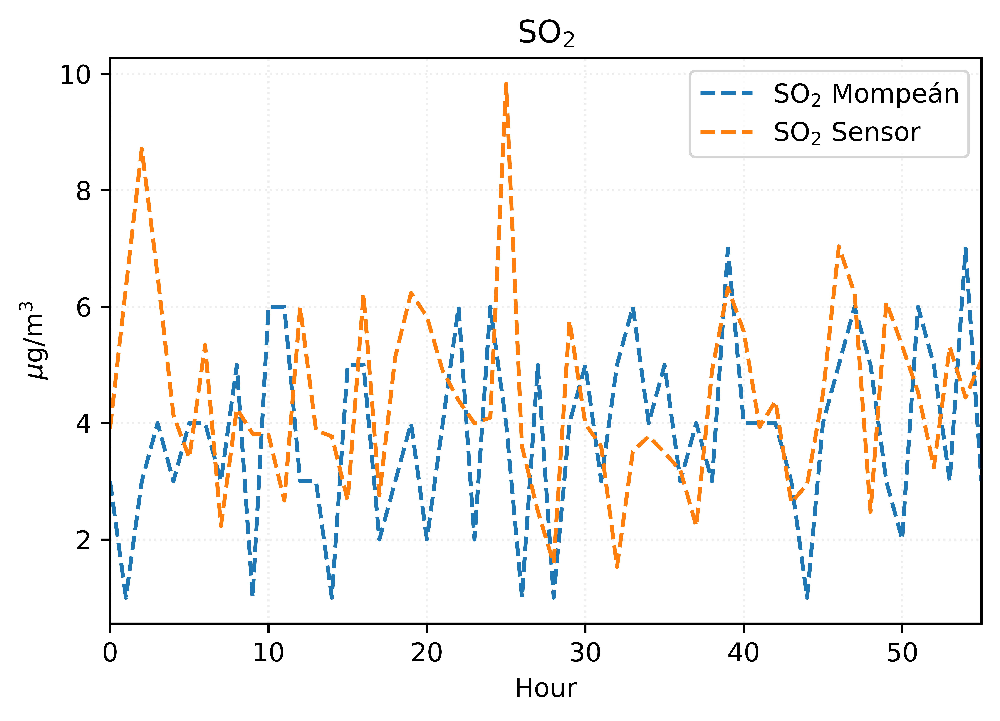

In [82]:
# SO2 with tempereature and humidity

poly = PolynomialFeatures(degree=4)
X_multi_trans = poly.fit_transform(SO2TH)
print("Input",poly.n_input_features_)
print("Ouput",poly.n_output_features_)
print("Powersn",poly.powers_)
reg = LinearRegression()
reg.fit(X_multi_trans, SO2_mo)
print(reg.score(X_multi_trans,SO2_mo))
print(reg.coef_)
print(reg.intercept_)
X_multi_trans = poly.fit_transform(SO2TH)
plotting(X_multi_trans, SO2_mot, reg)

# CO

In [102]:
CO = training_data[['CO_we','CO_ae']].values
COT = training_data[['CO_we','CO_ae','Temperatura']].values
COTH  = training_data[['CO_we','CO_ae','Temperatura','Humedad']].values
CO_we = training_data[['CO_we']].values
CO_mo = training_data[['CO_Mompean']].values

COt = testing_data[['CO_we','CO_ae']].values
COTt = testing_data[['CO_we','CO_ae','Temperatura']].values
COTHt  = testing_data[['CO_we','CO_ae','Temperatura','Humedad']].values
CO_wet = testing_data[['CO_we']].values
CO_mot = testing_data[['CO_Mompean']].values

# Linear

0.38078041283083663
[[ 0.00229295 -0.00158236]]


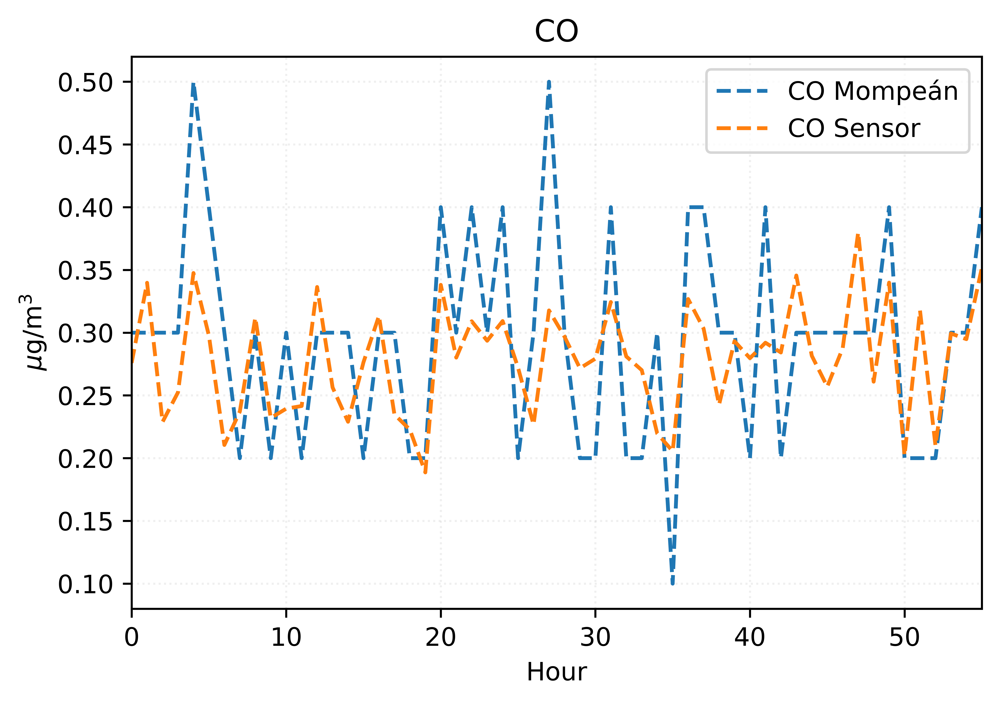

In [103]:
reg = LinearRegression().fit(CO, CO_mo)
print(reg.score(CO, CO_mo))
print(reg.coef_)

def plotting(X,Y,model):    
    fig = plt.figure(figsize=(6, 4), dpi = 1200)

    ax = fig.gca()
    ax.plot(range(0, len(Y)), Y, label=r'CO Mompeán', ls='--')
    ax.plot(range(0, len(X)), model.predict(X), label=r'CO Sensor', ls='--')

    ax.set_xlim(0, len(Y)-1)

    ax.set_xlabel(r'Hour')
    ax.set_ylabel(r'$\mu$g/m$^3$')
    ax.set_title(r'CO')

    ax.grid(ls='dotted', alpha=0.2)
    ax.legend()

    plt.show()
    
plotting(COt,CO_mot,reg)

0.38199918129221344
[[ 0.00229792 -0.00160151  0.0005567 ]]


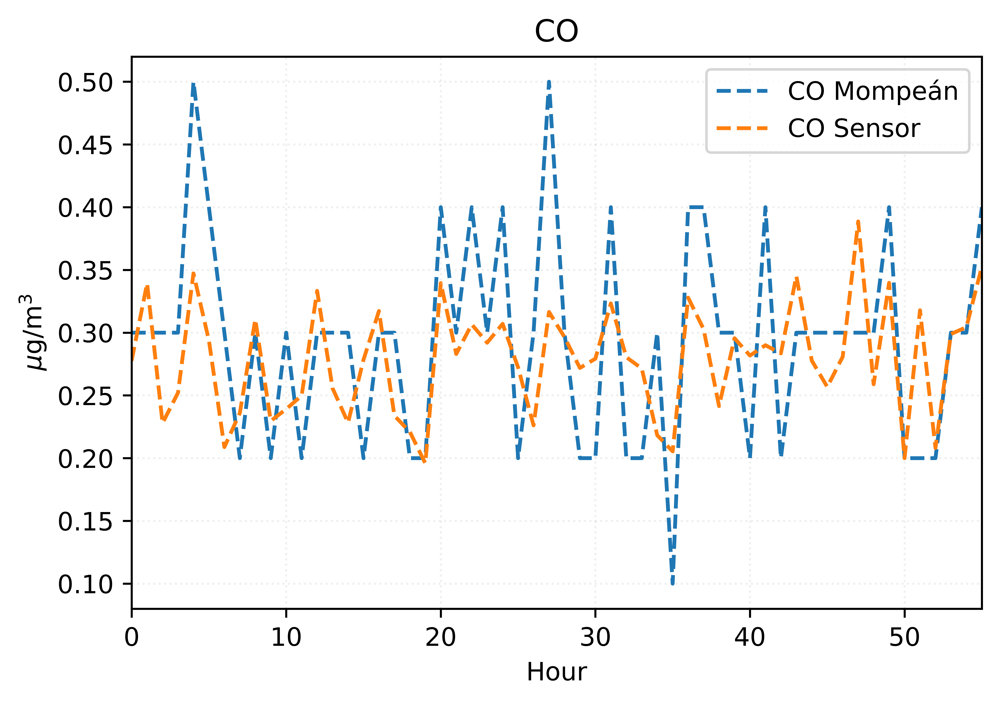

In [104]:
#CO with temperature
reg = LinearRegression().fit(COT, CO_mo)
print(reg.score(COT, CO_mo))
print(reg.coef_)
plotting(COTt, CO_mot, reg)

0.44469040517168823
[[ 0.00212185 -0.00139142  0.00425849  0.0021191 ]]


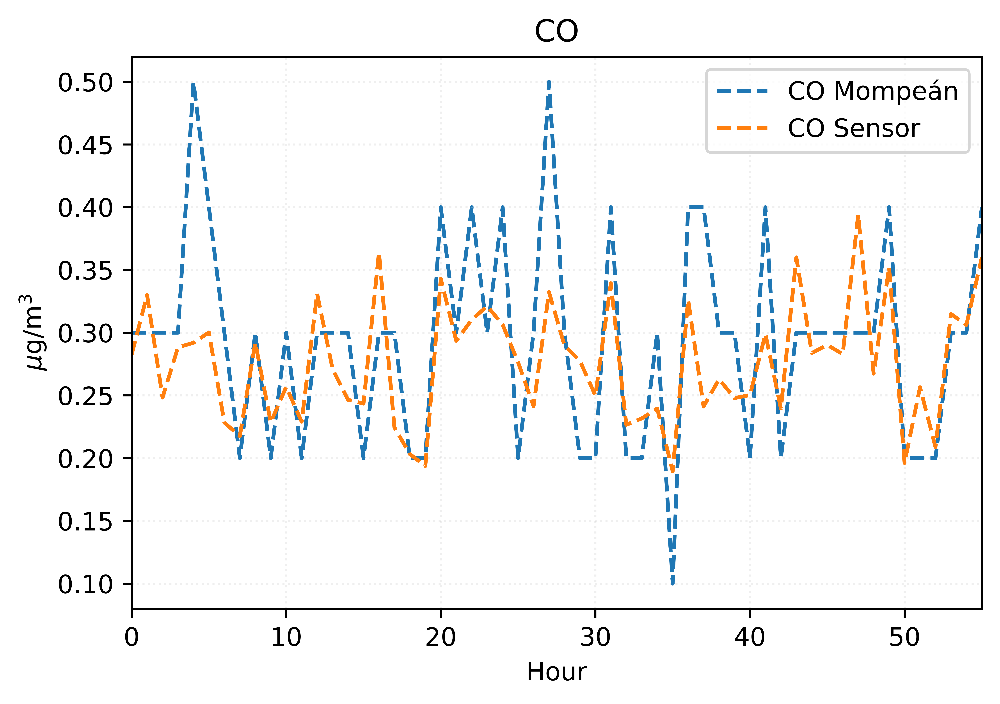

In [105]:
#CO with temperature and humidity
reg = LinearRegression().fit(COTH, CO_mo)
print(reg.score(COTH, CO_mo))
print(reg.coef_)
plotting(COTHt, CO_mot, reg)

# Polynomial

C:\Users\Acer\.conda\envs\senv\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The attribute `n_input_features_` was deprecated in version 1.0 and will be removed in 1.2.
  warnings.warn(msg, category=FutureWarning)


Input 3
Ouput 10
Powersn [[0 0 0]
 [1 0 0]
 [0 1 0]
 [0 0 1]
 [2 0 0]
 [1 1 0]
 [1 0 1]
 [0 2 0]
 [0 1 1]
 [0 0 2]]
0.41221597211172334
[[ 0.00000000e+00 -9.38645464e-03  2.74084139e-03  1.31843898e-02
   1.21731198e-05  3.91541043e-06 -6.56445539e-06 -8.04986121e-06
  -2.19800642e-05 -2.46935332e-05]]
[1.47604728]


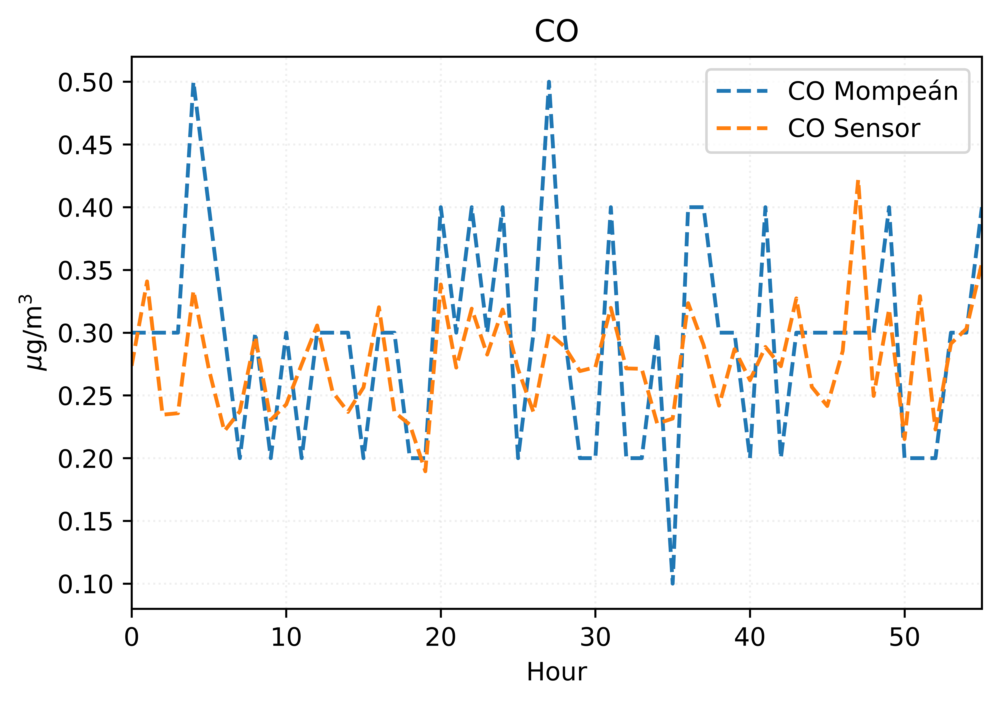

In [85]:
# CO with temperature

poly = PolynomialFeatures(degree=2)
X_multi_trans = poly.fit_transform(COT)
print("Input",poly.n_input_features_)
print("Ouput",poly.n_output_features_)
print("Powersn",poly.powers_)
reg = LinearRegression()
reg.fit(X_multi_trans, CO_mo)
print(reg.score(X_multi_trans,CO_mo))
print(reg.coef_)
print(reg.intercept_)
X_multi_trans = poly.fit_transform(COTt)
plotting(X_multi_trans, CO_mot, reg)

C:\Users\Acer\.conda\envs\senv\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The attribute `n_input_features_` was deprecated in version 1.0 and will be removed in 1.2.
  warnings.warn(msg, category=FutureWarning)


Input 4
Ouput 70
Powersn [[0 0 0 0]
 [1 0 0 0]
 [0 1 0 0]
 [0 0 1 0]
 [0 0 0 1]
 [2 0 0 0]
 [1 1 0 0]
 [1 0 1 0]
 [1 0 0 1]
 [0 2 0 0]
 [0 1 1 0]
 [0 1 0 1]
 [0 0 2 0]
 [0 0 1 1]
 [0 0 0 2]
 [3 0 0 0]
 [2 1 0 0]
 [2 0 1 0]
 [2 0 0 1]
 [1 2 0 0]
 [1 1 1 0]
 [1 1 0 1]
 [1 0 2 0]
 [1 0 1 1]
 [1 0 0 2]
 [0 3 0 0]
 [0 2 1 0]
 [0 2 0 1]
 [0 1 2 0]
 [0 1 1 1]
 [0 1 0 2]
 [0 0 3 0]
 [0 0 2 1]
 [0 0 1 2]
 [0 0 0 3]
 [4 0 0 0]
 [3 1 0 0]
 [3 0 1 0]
 [3 0 0 1]
 [2 2 0 0]
 [2 1 1 0]
 [2 1 0 1]
 [2 0 2 0]
 [2 0 1 1]
 [2 0 0 2]
 [1 3 0 0]
 [1 2 1 0]
 [1 2 0 1]
 [1 1 2 0]
 [1 1 1 1]
 [1 1 0 2]
 [1 0 3 0]
 [1 0 2 1]
 [1 0 1 2]
 [1 0 0 3]
 [0 4 0 0]
 [0 3 1 0]
 [0 3 0 1]
 [0 2 2 0]
 [0 2 1 1]
 [0 2 0 2]
 [0 1 3 0]
 [0 1 2 1]
 [0 1 1 2]
 [0 1 0 3]
 [0 0 4 0]
 [0 0 3 1]
 [0 0 2 2]
 [0 0 1 3]
 [0 0 0 4]]
0.7143514570643827
[[ 1.54672246e-03  4.25519636e+00  2.72878102e+00  8.35087336e+00
   2.99045370e+00 -7.13474566e-03 -1.53191965e-02 -6.71556970e-03
  -8.13895967e-03  1.53771713e-03 -7.12828744e-02 -1.

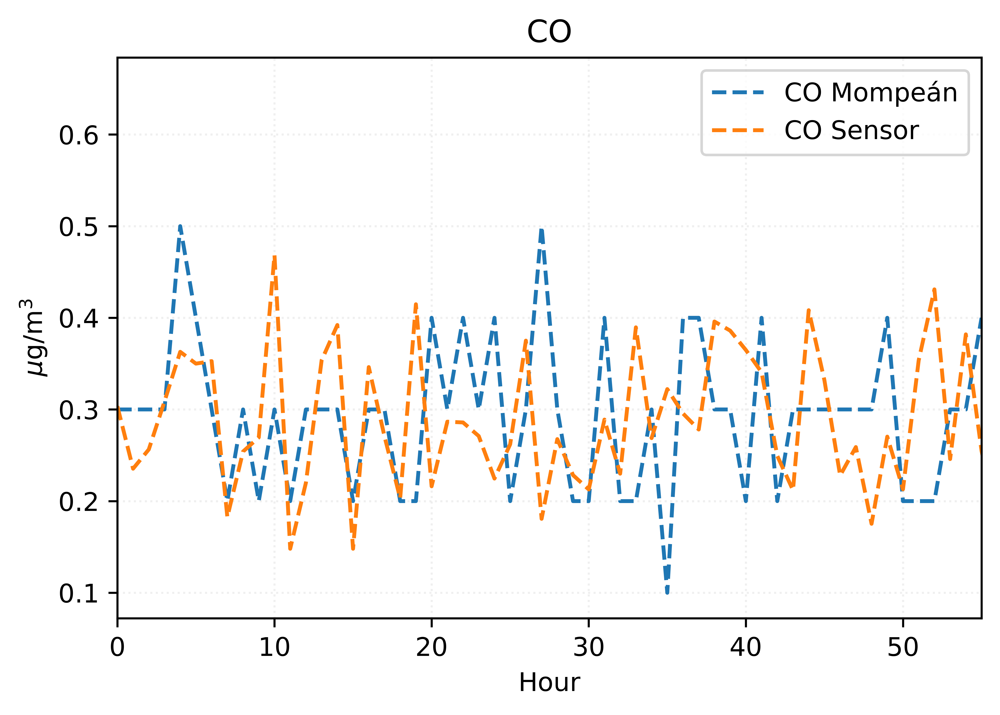

In [86]:
# CO with tempereature and humidity

poly = PolynomialFeatures(degree=4)
X_multi_trans = poly.fit_transform(COTH)
print("Input",poly.n_input_features_)
print("Ouput",poly.n_output_features_)
print("Powersn",poly.powers_)
reg = LinearRegression()
reg.fit(X_multi_trans, CO_mo)
print(reg.score(X_multi_trans,CO_mo))
print(reg.coef_)
print(reg.intercept_) 
X_multi_trans = poly.fit_transform(COTH)
plotting(X_multi_trans, CO_mot, reg)

# O3

In [5]:
O3 = training_data[['O3_we','O3_ae']].values
O3T = training_data[['O3_we','O3_ae','Temperatura']].values
O3TH  = training_data[['O3_we','O3_ae','Temperatura','Humedad']].values
O3_we = training_data[['O3_we']].values
O3_mo = training_data[['O3_Mompean']].values

O3t = testing_data[['O3_we','O3_ae']].values
O3Tt = testing_data[['O3_we','O3_ae','Temperatura']].values
O3THt  = testing_data[['O3_we','O3_ae','Temperatura','Humedad']].values
O3_wet = testing_data[['O3_we']].values
O3_mot = testing_data[['O3_Mompean']].values

# Linear

0.18822256312398544
[[ 0.84041222 -0.53983496]]


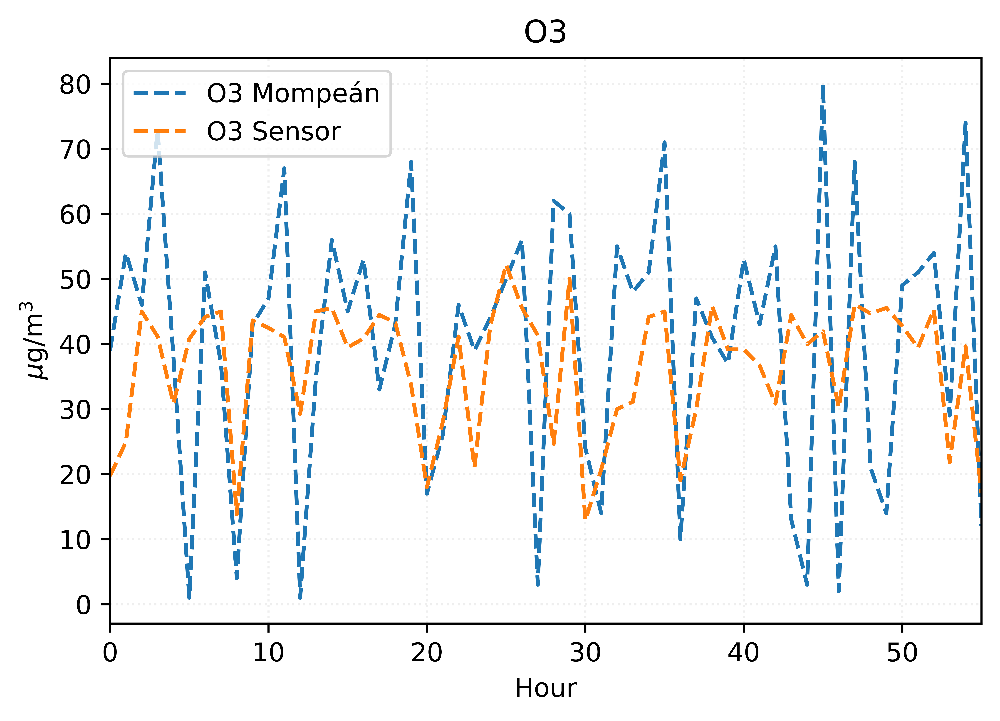

In [8]:
reg = LinearRegression().fit(O3, O3_mo)
print(reg.score(O3, O3_mo))
print(reg.coef_)

def plotting(X,Y,model):    
    fig = plt.figure(figsize=(6, 4), dpi = 1200)

    ax = fig.gca()
    ax.plot(range(0, len(Y)), Y, label=r'O3 Mompeán', ls='--')
    ax.plot(range(0, len(X)), model.predict(X), label=r'O3 Sensor', ls='--')

    ax.set_xlim(0, len(Y)-1)

    ax.set_xlabel(r'Hour')
    ax.set_ylabel(r'$\mu$g/m$^3$')
    ax.set_title(r'O3')

    ax.grid(ls='dotted', alpha=0.2)
    ax.legend()

    plt.show()
    
plotting(O3t,O3_mot,reg)

0.511535669661284
[[ 0.7526115  -0.36863505  2.29546873]]


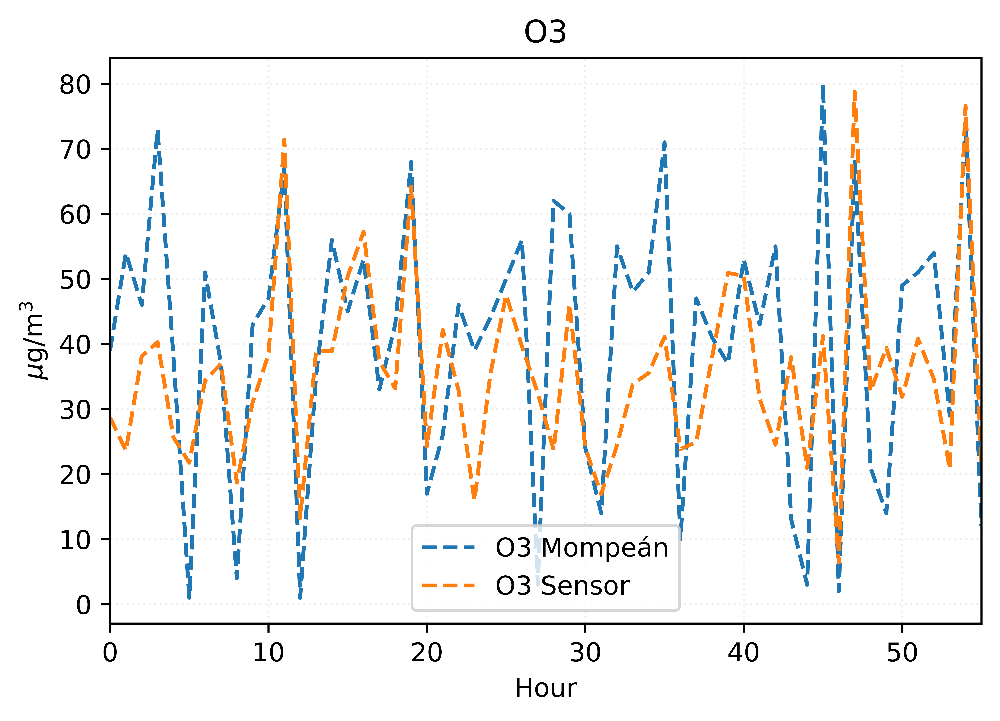

In [9]:
# O3 with temperature
reg = LinearRegression().fit(O3T, O3_mo)
print(reg.score(O3T, O3_mo))
print(reg.coef_)
plotting(O3Tt,O3_mot,reg)

0.5140447872869844
[[ 0.74303465 -0.36939346  2.10048066 -0.10399919]]


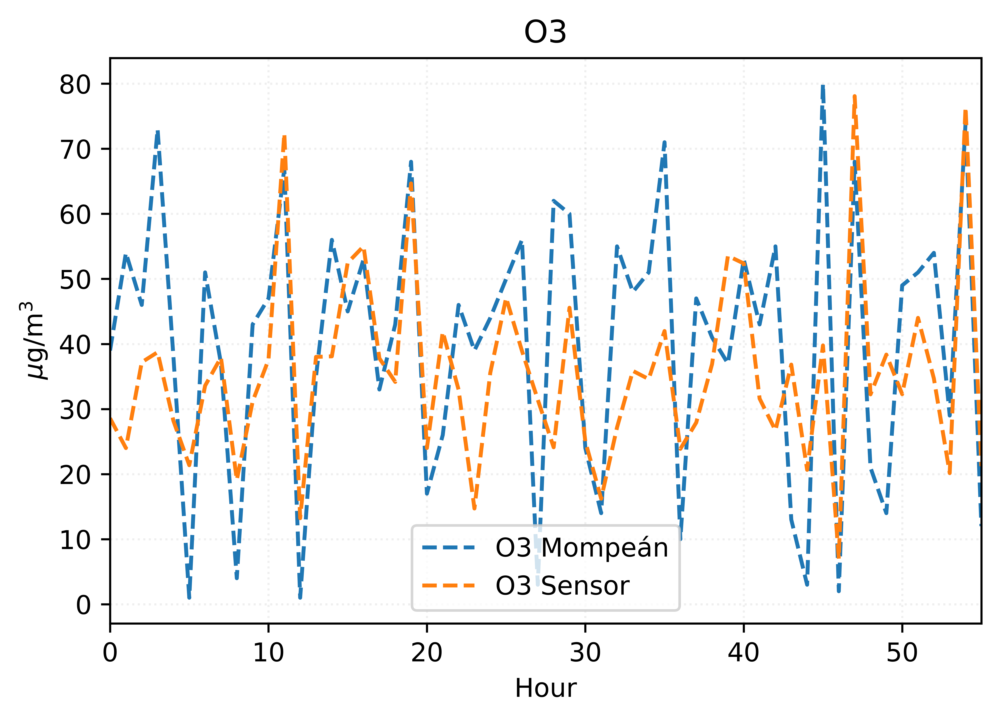

In [11]:
# O3 with temperature and humidity
reg = LinearRegression().fit(O3TH, O3_mo)
print(reg.score(O3TH, O3_mo))
print(reg.coef_)
plotting(O3THt,O3_mot,reg)

# Polynomial

C:\Users\Acer\.conda\envs\senv\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The attribute `n_input_features_` was deprecated in version 1.0 and will be removed in 1.2.
  warnings.warn(msg, category=FutureWarning)


Input 3
Ouput 10
Powersn [[0 0 0]
 [1 0 0]
 [0 1 0]
 [0 0 1]
 [2 0 0]
 [1 1 0]
 [1 0 1]
 [0 2 0]
 [0 1 1]
 [0 0 2]]
0.5845942993873492
[[ 0.         -1.67050468 -0.44338252 11.59202657  0.0323775  -0.05077169
  -0.05883963  0.02322407  0.02971322 -0.06123256]]
[197.15801016]


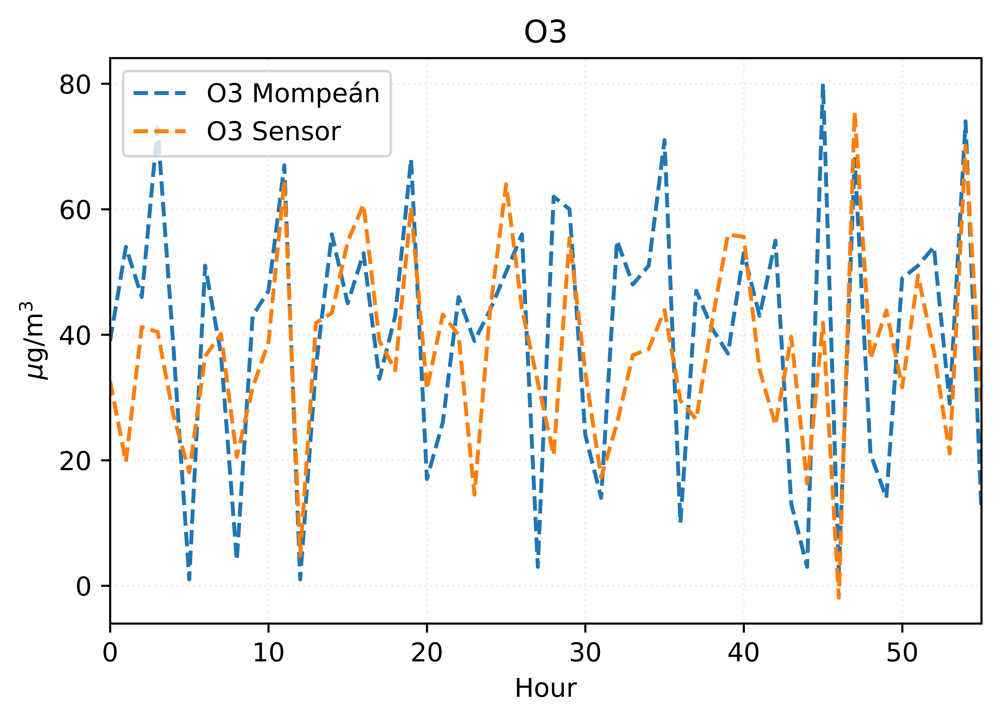

In [19]:
# O3 with temperature

poly = PolynomialFeatures(degree=2)
X_multi_trans = poly.fit_transform(O3T)
print("Input",poly.n_input_features_)
print("Ouput",poly.n_output_features_)
print("Powersn",poly.powers_)
reg = LinearRegression()
reg.fit(X_multi_trans, O3_mo)
print(reg.score(X_multi_trans,O3_mo))
print(reg.coef_)
print(reg.intercept_)
X_multi_trans = poly.fit_transform(O3Tt)
plotting(X_multi_trans, O3_mot, reg)

In [14]:
# O3 with tempereature and humidity

poly = PolynomialFeatures(degree=4)
X_multi_trans = poly.fit_transform(O3TH)
print("Input",poly.n_input_features_)
print("Ouput",poly.n_output_features_)
# print("Powersn",poly.powers_)
reg = LinearRegression()
reg.fit(X_multi_trans, O3_mo)
print(reg.score(X_multi_trans,O3_mo))
print(reg.coef_)
print(reg.intercept_)
X_multi_trans = poly.fit_transform(COTH)
plotting(X_multi_trans, O3_mot, reg)

NameError: name 'COTH' is not defined

# Test the model

# Practice

In [ ]:
x = 7 * np.random.rand(10, 1) - 2.8
y = 7 * np.random.rand(10, 1) - 2.8
z = x**2 + y**2 + 0.2*x + 0.2*y + 0.1*x*y +2 + np.random.randn(10, 1)

In [ ]:
print(x)
print('*********')
print(y)
print('*********')
print(z)

In [ ]:
X_multi = np.array([x,y]).reshape(10,1)
poly = PolynomialFeatures(degree=3)
X_multi_trans = poly.fit_transform(X_multi)
print("Input",poly.n_input_features_)
print("Ouput",poly.n_output_features_)
print("Powersn",poly.powers_)

In [ ]:
X_multi

In [ ]:
print(len(X_multi_trans))
X_multi_trans

In [ ]:
lr = LinearRegression()
lr.fit(X_multi_trans, z)
# X_test_multi = poly.transform(final)
# z_final = lr.predict(X_multi_trans).reshape(10,10)

In [ ]:
print(reg.intercept_)
print(lr.coef_)

In [ ]:
reg = LinearRegression().fit(X_multi,z)
print(reg.coef_)

# USING DEEP NEURAL NETWORK

In [ ]:
import keras
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [ ]:
df0=pd.read_csv('Data1/gases.csv')
df0.head()

In [ ]:
keras.__version__

In [ ]:
df1=pd.read_csv('Data1/gases_mompean_1.csv', )
print(df1.head())
df2=pd.read_csv('Data1/gases_mompean_2.csv', )
print(df2.head())
df3=pd.read_csv('Data1/gases_mompean_3.csv', )
print(df3.head())

In [ ]:
df = pd.concat([df0,df1, df2,df3], axis=0)

In [ ]:
df.head(10)

In [ ]:
training_data, testing_data = train_test_split(df, test_size=0.2, random_state=25)
print(f"No. of training examples: {training_data.shape[0]}")
print(f"No. of testing examples: {testing_data.shape[0]}")

In [ ]:
X_train = training_data[['NO2_we','NO2_ae','Temperatura','Humedad']].values
# X = df.drop(columns=['SalePrice'])
Y_train = training_data[['NO2_Mompean']].values
X_test = testing_data[['NO2_we','NO2_ae','Temperatura','Humedad']]
Y_test = testing_data[['NO2_Mompean']]

In [ ]:
model = keras.models.Sequential()

model.add(keras.layers.Dense(4, activation='relu', input_shape=(4,)))
model.add(keras.layers.Dense(4, activation='relu'))
model.add(keras.layers.Dense(4, activation='relu'))
model.add(keras.layers.Dense(1))
opt = keras.optimizers.Adam(learning_rate=0.01)

model.compile(optimizer=opt, loss='mean_squared_error',metrics=['accuracy'])

In [ ]:
history = model.fit(X_train, Y_train, epochs=75, validation_data = (X_test,Y_test))

In [ ]:
model.summary()

In [ ]:
y_pred = model.predict(X_test)
print(y_pred)

In [ ]:
test_data1 = np.array([231.119590, 228.038433,26.1,50.8])
test_data2 = np.array([227.624575, 227.931468,32.4,38.6])
print(model.predict(test_data1.reshape(1,4), batch_size=1))
print(model.predict(test_data2.reshape(1,4), batch_size=1))

In [ ]:
print(history.history.keys())
#  "Accuracy"
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
# "Loss"
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
output = model.predict(X)
print(output)

In [ ]:
fig = plt.figure(figsize=(6, 4), dpi = 1200)

ax = fig.gca()
ax.plot(range(0, len(Y)), Y, label=r'NO$_{2}$ Mompeán', ls='--')
ax.plot(range(0, len(X)), output, label=r'NO$_{2}$ Sensor', ls='--')

ax.set_xlim(0, len(Y)-1)

ax.set_xlabel(r'Hour')
ax.set_ylabel(r'$\mu$g/m$^3$')
ax.set_title(r'NO$_2$')

ax.grid(ls='dotted', alpha=0.2)
ax.legend()

plt.show()

In [ ]:
# model.save('saved_model.h5')
# old_model = keras.models.load_model('saved_model.h5')

# test_data = np.array([2003,854,1710,2,1,3,8,2008])
# print(old_model.predict(test_data.reshape(1,8), batch_size=1))

In [ ]:
test_data

In [ ]:
df=pd.read_csv('Data1/gases_mompean_2.csv', )

In [ ]:
df.head()

In [ ]:
X = df[['NO2_we','NO2_ae','Temperatura','Humedad']]
# X = df.drop(columns=['SalePrice'])
Y = df[['NO2_Mompean']]

In [ ]:
X

In [ ]:
Y

In [ ]:
len(X)

# Without temperature and humidity

In [ ]:
df = pd.read_csv('Data1/gases.csv')
print(df.head())
training_data, testing_data = train_test_split(df, test_size=0.2, random_state=25)
print(f"No. of training examples: {training_data.shape[0]}")
print(f"No. of testing examples: {testing_data.shape[0]}")

In [ ]:
X_train = training_data[['NO2_we','NO2_ae']]
# X = df.drop(columns=['SalePrice'])
Y_train = training_data[['NO2_Mompean']]
X_test = testing_data[['NO2_we','NO2_ae']]
Y_test = testing_data[['NO2_Mompean']]

#defining model
model = keras.models.Sequential()

model.add(keras.layers.Dense(2, activation='relu', input_shape=(2,)))
model.add(keras.layers.Dense(2, activation='relu'))
model.add(keras.layers.Dense(1))
opt = keras.optimizers.Adam(learning_rate=0.01)

model.compile(optimizer=opt, loss='mean_squared_error',metrics=['accuracy'])

#training 

history = model.fit(X_train, Y_train, epochs=100, validation_data = (X_test,Y_test))
print(model.summary())







In [ ]:
test_data1 = np.array([231.119590, 228.038433])
test_data2 = np.array([227.624575, 227.931468])
print(model.predict(test_data1.reshape(1,2), batch_size=1))
print(model.predict(test_data2.reshape(1,2), batch_size=1))


In [ ]:
print(history.history.keys())
#  "Accuracy"
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
# "Loss"
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
output = model.predict(X_train)
print(output)